In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [2]:
%%capture
!apt install libasound2-dev portaudio19-dev libportaudio2 libportaudiocpp0 ffmpeg
!pip install pyaudio

In [3]:
import io
import os
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.ticker import MultipleLocator
import pyaudio
import wave
import base64
import soundfile as sf
from scipy.fft import fft, fftfreq
from scipy.signal import find_peaks
from scipy.io.wavfile import write
from IPython.display import display, Audio, HTML

In [4]:
# Some Tool Functions

# Plotting Functions
def initialize_plot(title="Title", xlabel="X", ylabel="Y", figsize=(10, 4)):
    plt.figure(figsize=figsize)
    plt.title(title)
    plt.xlabel(xlabel)
    plt.ylabel(ylabel)
    plt.gca().xaxis.set_major_locator(MultipleLocator(500))
    plt.grid(True)

def plot_signal(x, y, title="Title", xlabel="X", ylabel="Y"):
    initialize_plot(title, xlabel, ylabel)
    plt.plot(x, y)
    plt.show()

def plot_multi_signals(data_pairs, title="Title"):
    num_plots = len(data_pairs)
    plt.figure(figsize=(5 * num_plots, 4))

    for i, (x, y, plot_title, xlabel, ylabel) in enumerate(data_pairs, start=1):
        plt.subplot(1, num_plots, i)
        plt.plot(x, y)
        plt.title(plot_title)
        plt.xlabel(xlabel)
        plt.ylabel(ylabel)
        plt.grid(True)

    plt.suptitle(title)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

def plot_frequency_spectrum_with_harmonics(frequencies, spectrum, peak_freqs=None, peak_magnitudes=None,
                                           title="Frequency Spectrum with Harmonics", xlabel="Frequency (Hz)", ylabel="Magnitude",
                                           xlim=None, show=True):
    initialize_plot(title, xlabel, ylabel, figsize=(15, 4))
    plt.plot(frequencies, spectrum, label='Spectrum')
    if peak_freqs is not None and peak_magnitudes is not None:
        plt.plot(peak_freqs, peak_magnitudes, 'x', label='Harmonics')
    plt.legend()

    if xlim is not None:
        plt.xlim(xlim)

    if show:
        plt.show()

def save_plot_as_base64(width=1200, bbox_inches='tight'):  # bbox_inches='tight': rm excess margins around the plot
    buf = io.BytesIO()
    plt.savefig(buf, format="png", bbox_inches=bbox_inches)
    plt.close('all')
    buf.seek(0)
    img_base64 = base64.b64encode(buf.read()).decode("utf-8")
    return img_base64

# Html Components
def audio_html(file_path):
  if not file_path or not os.path.exists(file_path):
    return None

  return f"{Audio(file_path)._repr_html_()}"

def audio_and_harmonics_html(audio_path, peaks):
    harmonics_html = "<h4>Harmonics:</h4>" + "".join(
        f"<div>[{i}] Frequency = {freq:.2f} Hz, Amplitude = {mag:.2f}</div>"
        for i, (freq, mag) in enumerate(peaks)
    )

    html_output = f"""
      <div style="font-size: 14px; text-align: left;">
          {audio_html(audio_path)}
          {harmonics_html}
      </div>
    """
    return html_output


def base64_img_html(img_base64, width=500):
    return f"<img src='data:image/png;base64,{img_base64}' width='{width}'>"

In [5]:
# Set file paths

instruments = ["piano", "harp", "violin", "flute", "clarinet", "oboe", "trumpet", "horn", "drum", "cymbal", "harp_1-2", "harp_1-3", "harp_1-4", 'harp_1-10']
notes = ["C4", "D4", "E4", "hit"]

def get_real_audio_path(instrument, note):
    path = f"/content/drive/MyDrive/instruments-simulation/assets/audios/real_{instrument}/{note}.wav"
    return path if os.path.exists(path) else None

def get_synthesized_auido_path(instrument, note):
    path = f"/content/synthesized_{instrument}/{note}.wav"
    return path if os.path.exists(path) else None


real_audio_paths = {
    instrument: {note: get_real_audio_path(instrument, note) for note in notes}
    for instrument in instruments
}

synthesized_audio_paths = {
    instrument: {
      note: get_synthesized_auido_path(instrument, note)
      for note in notes
    }
    for instrument in instruments
}

print(real_audio_paths)
print(synthesized_audio_paths)


{'piano': {'C4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_piano/C4.wav', 'D4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_piano/D4.wav', 'E4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_piano/E4.wav', 'hit': None}, 'harp': {'C4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_harp/C4.wav', 'D4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_harp/D4.wav', 'E4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_harp/E4.wav', 'hit': None}, 'violin': {'C4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_violin/C4.wav', 'D4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_violin/D4.wav', 'E4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_violin/E4.wav', 'hit': None}, 'flute': {'C4': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_flute/C4.wav', 'D4': '/content/drive/MyDrive/instruments-simul

# Analysis

Some fundamental frequencies:<br>
C4 = 261.63<br>
D4 = 293.66<br>
E4 = 329.63<br>
F4 = 349.23<br>
G4 = 392.00<br>
A4 = 440.00<br>
B4 = 493.88

In [6]:
display(Audio(real_audio_paths['piano']['C4']))
display(Audio(real_audio_paths['harp']['C4']))
# display(Audio(real_audio_paths['flute']['C4']))

**Analyzing the frequencies of a single audio**

---------- Piano C4 ----------
audio:  [[0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 0.00000000e+00]
 [0.00000000e+00 6.10351562e-05]
 ...
 [0.00000000e+00 6.10351562e-05]
 [0.00000000e+00 3.05175781e-05]
 [0.00000000e+00 0.00000000e+00]] 
audio.shape:  (396900, 2) 
sample_rate: 44100
(After audio.mean) audio:  [0.00000000e+00 0.00000000e+00 3.05175781e-05 ... 3.05175781e-05
 1.52587891e-05 0.00000000e+00] 
audio.shape:  (396900,)
origin_fft:
 [-0.05545044-0.j          0.20413481+0.08875789j  0.41538886+0.1156603j
 ...  0.53601962-0.17996306j  0.41538886-0.1156603j
  0.20413481-0.08875789j]
origin_fft_abs:
 [0.05545044 0.22259601 0.43119045 ... 0.56542351 0.43119045 0.22259601]
spectrum_amplitudes:
 [0.05545044 0.22259601 0.43119045 ... 0.00415893 0.01235489 0.00902682]
np.max(spectrum_amplitudes):
 2759.402766184614
frequencies:
 [0.00000000e+00 1.11111111e-01 2.22222222e-01 ... 2.20496667e+04
 2.20497778e+04 2.20498889e+04]
np.max(frequencies): 22049.888888888887


/usr/local/lib/python3.10/dist-packages/matplotlib/cbook.py:1699: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/usr/local/lib/python3.10/dist-packages/matplotlib/cbook.py:1345: ComplexWarning: Casting complex values to real discards the imaginary part
  return np.asarray(x, float)


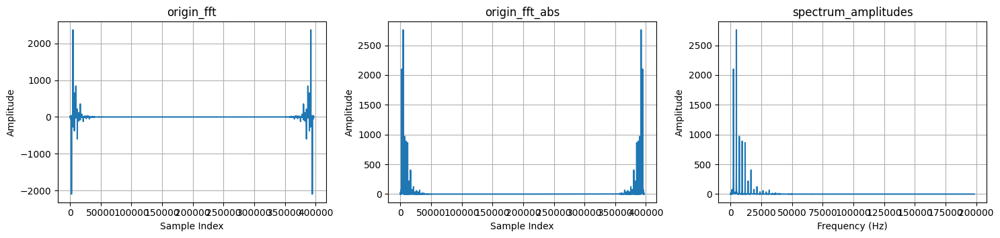

peak_indices: [ 2355  4661  4713  4779  7076  9446 11825 14216 16626]
peaks:
 [(261.66666666666663, 2100.354122259287), (517.8888888888889, 142.76597555356247), (523.6666666666666, 2759.402766184614), (531.0, 148.4347953142307), (786.2222222222222, 968.8628768549794), (1049.5555555555554, 888.4315054210066), (1313.888888888889, 863.8636775847955), (1579.5555555555554, 219.35241217475658), (1847.3333333333333, 403.53033183823794)]


{'frequencies': array([0.00000000e+00, 1.11111111e-01, 2.22222222e-01, ...,
        2.20496667e+04, 2.20497778e+04, 2.20498889e+04]),
 'spectrum_amplitudes': array([0.05545044, 0.22259601, 0.43119045, ..., 0.00415893, 0.01235489,
        0.00902682]),
 'peaks': [(261.66666666666663, 2100.354122259287),
  (517.8888888888889, 142.76597555356247),
  (523.6666666666666, 2759.402766184614),
  (531.0, 148.4347953142307),
  (786.2222222222222, 968.8628768549794),
  (1049.5555555555554, 888.4315054210066),
  (1313.888888888889, 863.8636775847955),
  (1579.5555555555554, 219.35241217475658),
  (1847.3333333333333, 403.53033183823794)],
 'sample_rate': 44100}

In [7]:
def get_audio_recipe(file_path, show_details=False):
  if not file_path or not os.path.exists(file_path):
    return None

  audio, sample_rate = sf.read(file_path)
  if show_details:
      print('audio: ', audio, '\naudio.shape: ', audio.shape, '\nsample_rate:', sample_rate)

  # If the audio is stereo, convert the signal to mono (by averaging across channels)
  if audio.ndim > 1:
      audio = audio.mean(axis=1)
      if show_details:
          print('(After audio.mean) audio: ', audio, '\naudio.shape: ', audio.shape)

  # Convert signal to frequency spectrum (using Fast Fourier Transform)
  N = len(audio)
  origin_fft = fft(audio)
  origin_fft_abs = np.abs(origin_fft)
  spectrum_amplitudes = origin_fft_abs[:N // 2]  # only take the positive part.
  frequencies = fftfreq(N, 1 / sample_rate)[:N // 2]

  if show_details:
    print('\033[1morigin_fft:\n\033[0m', origin_fft)
    print('\033[1morigin_fft_abs:\n\033[0m',  origin_fft_abs)
    print('\033[1mspectrum_amplitudes:\n\033[0m',  spectrum_amplitudes)
    print('\033[1mnp.max(spectrum_amplitudes):\n\033[0m',  np.max(spectrum_amplitudes))
    print('\033[1mfrequencies:\n\033[0m',  frequencies)
    print('\033[1mnp.max(frequencies):\033[0m',  np.max(frequencies))

    plot_multi_signals([
        (range(len(origin_fft)), origin_fft, "origin_fft", "Sample Index", "Amplitude"),
        (range(len(origin_fft_abs)), origin_fft_abs, "origin_fft_abs", "Sample Index", "Amplitude"),
        (range(len(spectrum_amplitudes)), spectrum_amplitudes, "spectrum_amplitudes", "Frequency (Hz)", "Amplitude")
    ], title="")

  peak_indices, _ = find_peaks(spectrum_amplitudes, height=0.05 * max(spectrum_amplitudes.flatten()), distance=20)
  peaks = [(frequencies[p], spectrum_amplitudes[p]) for p in peak_indices]

  if show_details:
    print('\033[1mpeak_indices:\033[0m',peak_indices)
    print('\033[1mpeaks:\n\033[0m',peaks)

  recipe = {'frequencies':frequencies, 'spectrum_amplitudes':spectrum_amplitudes, 'peaks':peaks, 'sample_rate':sample_rate}

  return recipe

print('-'*10,'\033[1mPiano C4\033[0m','-'*10)
get_audio_recipe(real_audio_paths['piano']['C4'], show_details=True)



In [8]:
# Get recipes for all files
def get_all_file_recipes():
  return {
    instrument: {
        note: {
            'audio_path': (audio_path := real_audio_paths[instrument][note]),
            'recipe': get_audio_recipe(audio_path)
        }
        for note in notes
    }
    for instrument in instruments
  }

recipes = get_all_file_recipes()
print(recipes)

{'piano': {'C4': {'audio_path': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_piano/C4.wav', 'recipe': {'frequencies': array([0.00000000e+00, 1.11111111e-01, 2.22222222e-01, ...,
       2.20496667e+04, 2.20497778e+04, 2.20498889e+04]), 'spectrum_amplitudes': array([0.05545044, 0.22259601, 0.43119045, ..., 0.00415893, 0.01235489,
       0.00902682]), 'peaks': [(261.66666666666663, 2100.354122259287), (517.8888888888889, 142.76597555356247), (523.6666666666666, 2759.402766184614), (531.0, 148.4347953142307), (786.2222222222222, 968.8628768549794), (1049.5555555555554, 888.4315054210066), (1313.888888888889, 863.8636775847955), (1579.5555555555554, 219.35241217475658), (1847.3333333333333, 403.53033183823794)], 'sample_rate': 44100}}, 'D4': {'audio_path': '/content/drive/MyDrive/instruments-simulation/assets/audios/real_piano/D4.wav', 'recipe': {'frequencies': array([0.00000000e+00, 1.11111111e-01, 2.22222222e-01, ...,
       2.20496667e+04, 2.20497778e+04, 2.20498889e


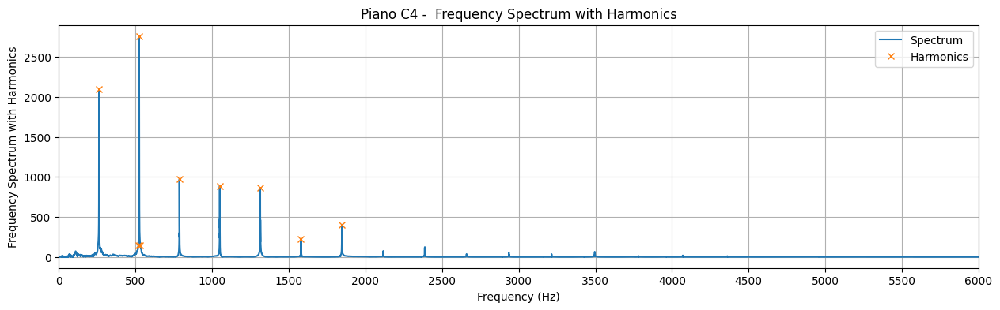


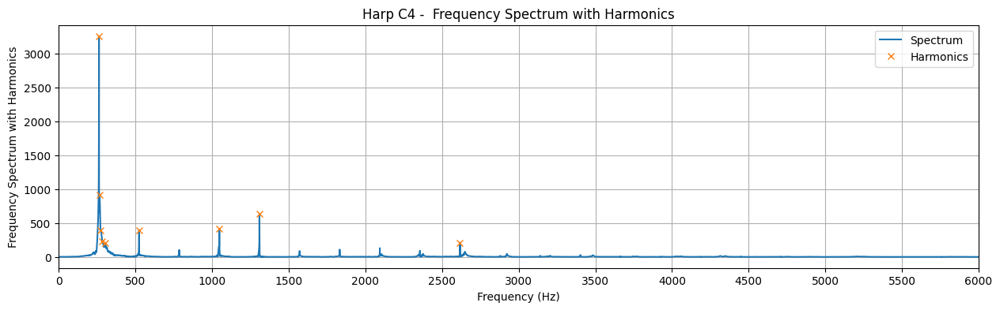

In [9]:
# Visualization of the Same Note across Different Instruments

# mode: display, save_img_base64
def plot_frequency_spectrum_with_peaks(file_path, recipe, title_prefix="", xlim=None, mode='display'):
    frequencies = recipe['frequencies']
    spectrum_amplitudes = recipe['spectrum_amplitudes']
    peaks = recipe['peaks']
    peak_xs, peak_ys = zip(*peaks) if peaks else ([], [])

    plot_frequency_spectrum_with_harmonics(frequencies, spectrum_amplitudes, peak_xs, peak_ys, title=f"{title_prefix} Frequency Spectrum with Harmonics",
                                            xlabel="Frequency (Hz)", ylabel="Frequency Spectrum with Harmonics", xlim=xlim, show=False)

    if mode == 'display':
      img_base64 = save_plot_as_base64()

      html_output = f"""
      <div style="display: flex; align-items: center; white-space: nowrap; margin-bottom: 30px">
          <div style="margin-right: 50px">
              {base64_img_html(img_base64, width=1200)}
          </div>
          <div style="font-size: 14px; text-align: left;">
              {audio_and_harmonics_html(file_path, peaks)}
          </div>
      </div>
      """
      display(HTML(html_output))

    if mode == 'save_img_base64':
      img_base64 = save_plot_as_base64()
      return img_base64

xlim=(0, 6000)
plot_frequency_spectrum_with_peaks(real_audio_paths['piano']['C4'], recipes['piano']['C4']['recipe'], title_prefix="Piano C4 - ", xlim=xlim)
plot_frequency_spectrum_with_peaks(real_audio_paths['harp']['C4'], recipes['harp']['C4']['recipe'], title_prefix="Harp C4 - ", xlim=xlim)
# plot_frequency_spectrum_with_peaks(real_audio_paths['flute']['C4'], recipes['flute']['C4']['recipe'], title_prefix="Flute C4 - ", xlim=xlim)



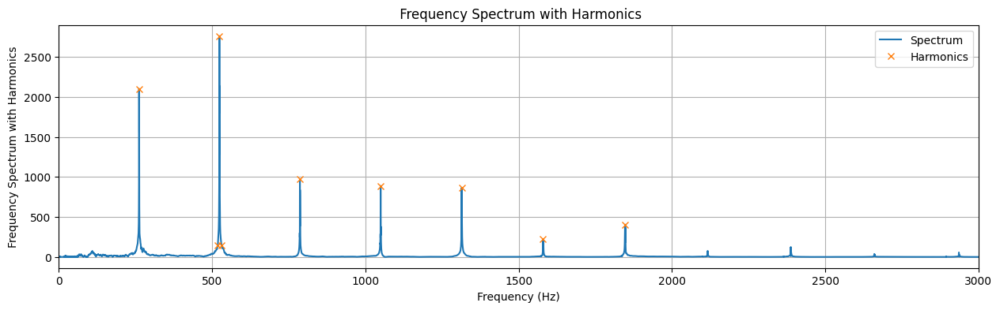
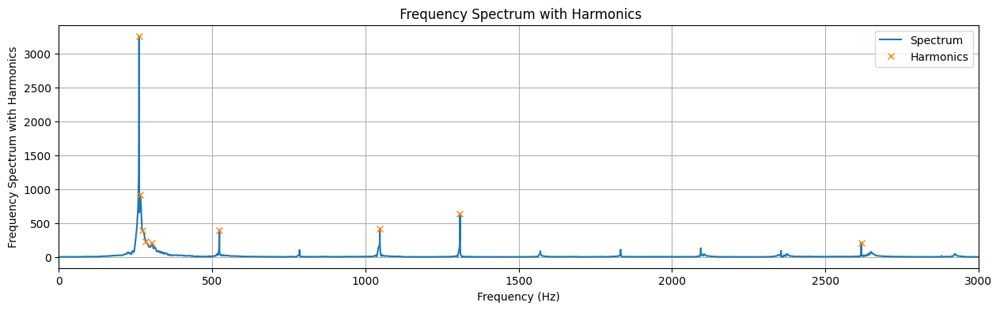
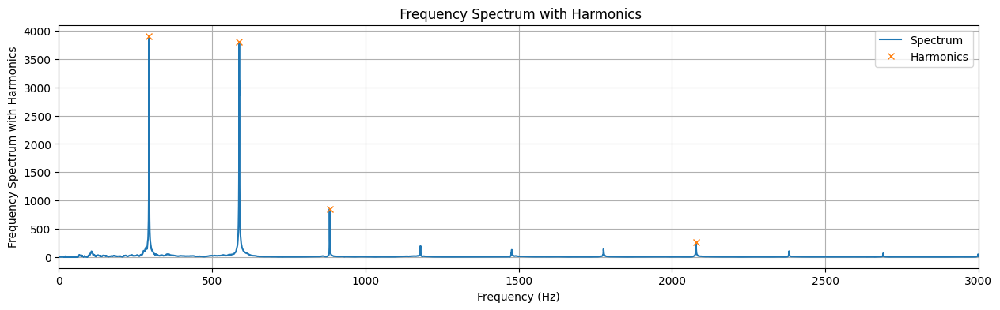
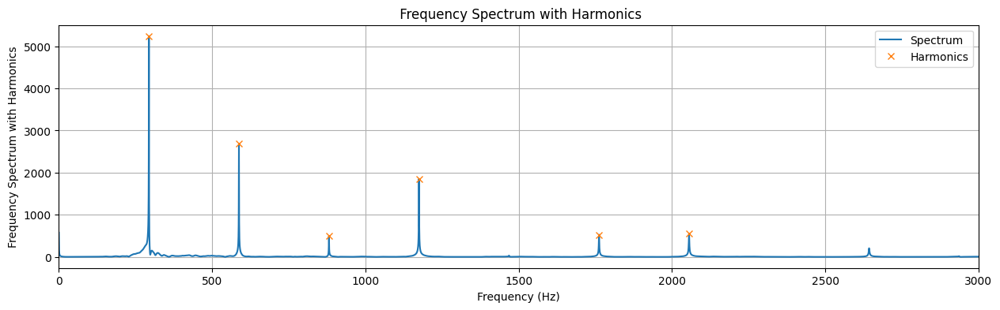
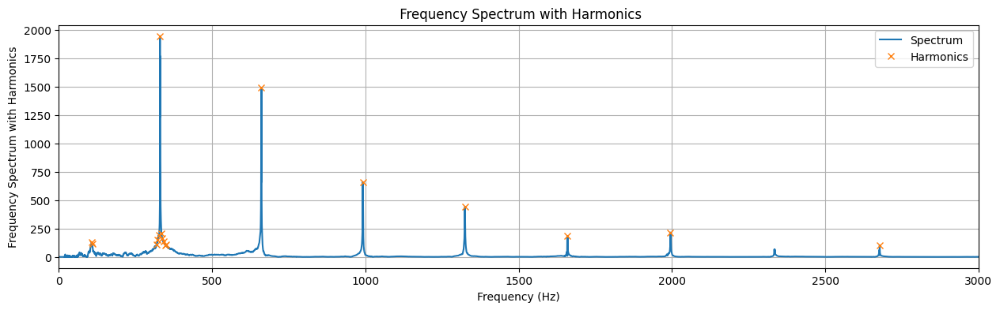
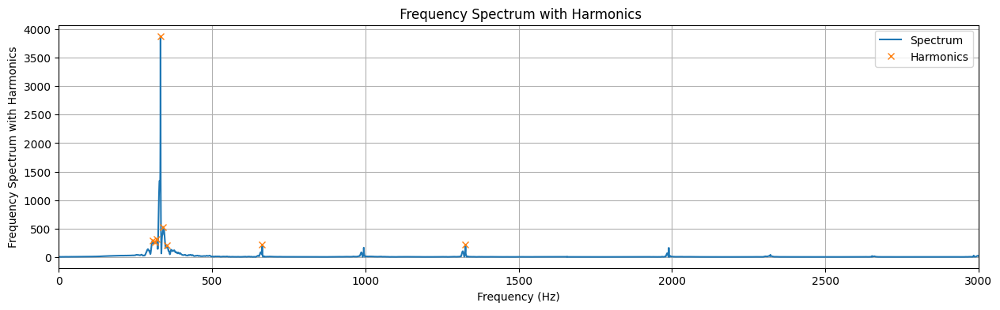

In [10]:
def display_recipe_matrix(recipes):
    instruments = list(recipes.keys())
    notes = list(next(iter(recipes.values())).keys())
    instruments_size = len(instruments)
    flex_basis = 100 / instruments_size

    instrument_names_html = "".join(
        f"""
          <div style='flex-basis: {flex_basis}%; text-align: center;'>
            <h3>{instrument.capitalize()}</h3>
          </div>
        """
        for instrument in instruments
    )


    def instrument_cols_html(note):
      return "".join(
        f"""
          <div style='flex-basis: {flex_basis}%; text-align: center;'>
            <h4>{note}</h4>
            <div>{base64_img_html(img_base64, width=550)}</div>"
            <div style='text-align: center; font-size: 15px;'>
              <div style='display: inline-block; text-align: left;'>
                {audio_and_harmonics_html(file_path, recipe['peaks'])}
              </div>
            </div>
          </div>
        """
        for instrument in instruments
        if (file_path := recipes[instrument][note]['audio_path']) and os.path.exists(file_path)
        if (recipe := recipes[instrument][note]['recipe'])
        if (img_base64 := plot_frequency_spectrum_with_peaks(file_path, recipe, title_prefix='', xlim=(0, 3000), mode='save_img_base64'))
    )

    note_rows_html = "".join(
        f"""<div style='display: flex; width: 100%; justify-content: center;'>
          {instrument_cols_html(note)}
        </div>"""
        for note in notes
    )

    margin_left = f"{instruments_size * 150}px" if instruments_size > 3 else "0px"
    html_output = f"""
      <div style='margin-left: {margin_left};'>
        <div style='display: flex; width: 100%; justify-content: center; margin-bottom: 10px;'>
          {instrument_names_html}
        </div>
        <div>
          {note_rows_html}
        </div>
      </div>
    """
    display(HTML(html_output))



def filter_recipes(recipes, selected_instruments, selected_notes):
    return {
        instrument: {
            note: recipes[instrument][note]
            for note in selected_notes if note in recipes[instrument]
        }
        for instrument in selected_instruments if instrument in recipes
    }

# selected_instruments = ['piano', 'harp', 'violin', 'flute', 'clarinet']
selected_instruments = ['piano', 'harp']
selected_notes = ['C4', 'D4', 'E4']
filtered_recipes = filter_recipes(recipes, selected_instruments, selected_notes)

display_recipe_matrix(filtered_recipes)


# Simulation

In [11]:
def generate_individual_tones_and_synthesized_audio(recipe_obj, duration=2):
    origin_audio_path = recipe_obj['audio_path']
    recipe = recipe_obj['recipe']
    sample_rate = recipe['sample_rate']
    peaks = recipe['peaks']

    # Create time array
    t = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)
    synthesized_audio = np.zeros_like(t)

    individual_tones = []
    for i, (freq, amp) in enumerate(peaks):
        tone = amp * np.sin(2 * np.pi * freq * t) # Create a single tone with specified frequency and amplitude

        tone_filename = f'tone_{i}_freq_{int(freq)}Hz.wav'
        write(tone_filename, sample_rate, (tone * 32767).astype(np.int16))

        individual_tones.append({'path': tone_filename, 'freq': freq, 'amp': amp})
        synthesized_audio += tone

    synthesized_audio = synthesized_audio / np.max(np.abs(synthesized_audio))

    synthesized_filename = 'synthesized_sound.wav'
    write(synthesized_filename, sample_rate, (synthesized_audio * 32767).astype(np.int16))

    return {
        'origin_audio_path': origin_audio_path,
        'synthesized_audio_path': synthesized_filename,
        'individual_tones': individual_tones
    }

def synthesize_individual_tones_html(recipes, instrument, note, duration=2):
    audios_obj = generate_individual_tones_and_synthesized_audio(recipes[instrument][note], duration)
    # print(audios_obj)
    return f"""
    <div style='margin: 0 20px 0 20px'>
      <h3 style='text-align: center;'>{instrument.capitalize()}-{note.capitalize()}</h3>
      <h4>Individual tones:</h4>
      <div>{''.join(f'''
            <div style='display: flex;'>
              {audio_html(tone['path'])}
              <div style='display: flex; margin-left: 10px'>
                <h4 style='margin-right: 10px'>{tone['freq']:.2f} Hz</h4>
                <h4>{tone['amp']:.2f}</h4>
              </div>
            </div>
          '''
          for tone in audios_obj['individual_tones']
      )}</div>
      <h4>Synthesized Audio:</h4>
      <div>{audio_html(audios_obj['synthesized_audio_path'])}</div>
      <h4>Origin Audio:</h4>
      <div>{audio_html(audios_obj['origin_audio_path'])}</div>
    </div>
  """

duration = 2

html_content = f"""
<div style='display: flex;'>
  <div>{synthesize_individual_tones_html(recipes, 'piano', 'C4', duration=duration)}</div>
  <div>{synthesize_individual_tones_html(recipes, 'harp', 'C4', duration=duration)}</div>
  <div>{synthesize_individual_tones_html(recipes, 'clarinet', 'C4', duration=duration)}</div>
</div>
"""
display(HTML(html_content))



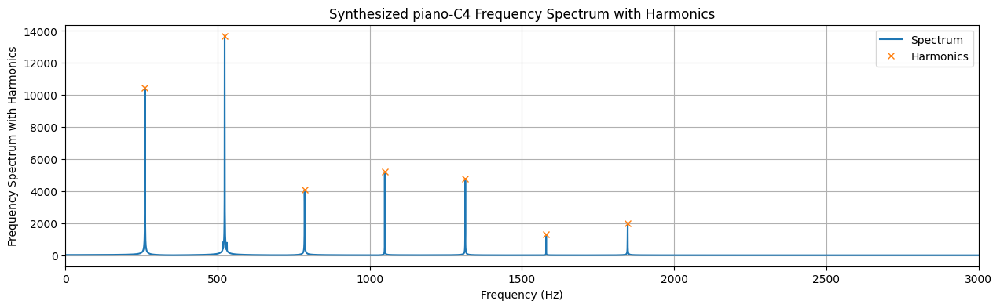


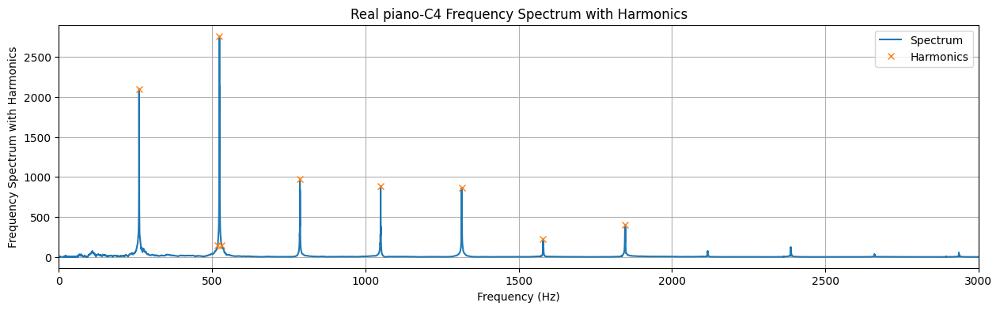

In [12]:
instrument = 'piano'
note = 'C4'

synthesized_audios_obj = generate_individual_tones_and_synthesized_audio(recipes[instrument][note], duration)
synthesized_audio_path = synthesized_audios_obj['synthesized_audio_path']
synthesized_recipe = get_audio_recipe(synthesized_audio_path)
plot_frequency_spectrum_with_peaks(synthesized_audio_path, synthesized_recipe, title_prefix=f"Synthesized {instrument}-{note}", xlim=(0, 3000))

real_aduio_recipe = recipes[instrument][note]
plot_frequency_spectrum_with_peaks(real_aduio_recipe['audio_path'], real_aduio_recipe['recipe'], title_prefix=f"Real {instrument}-{note}", xlim=(0, 3000))

# Physical Analysis

<table>
<tr>
   <h4></h4>
</tr>
<tr>
  <th><h4>String instruments（弦楽器）</h4>
  </th>
  <th><h4>Percussion instruments（打楽器）</h4>
  </th>
  <th><h4>Wind instruments（管楽器）</h4>
  </th>
</tr>
<tr>
  <td>
    <img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/string-instruments.jpg" width="300"/>
  </td>
  <td>
    <img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/drums.png" width="300"/>
  </td>
  <td>
    <img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/wind-instruments.jpg" width="300"/>
  </td>
</tr>
</table>


# String instruments（弦楽器）

<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/string-1.jpg" width="2000"/>


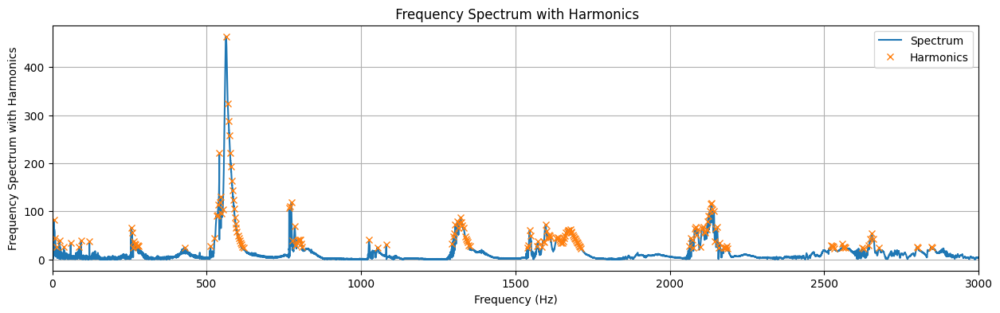
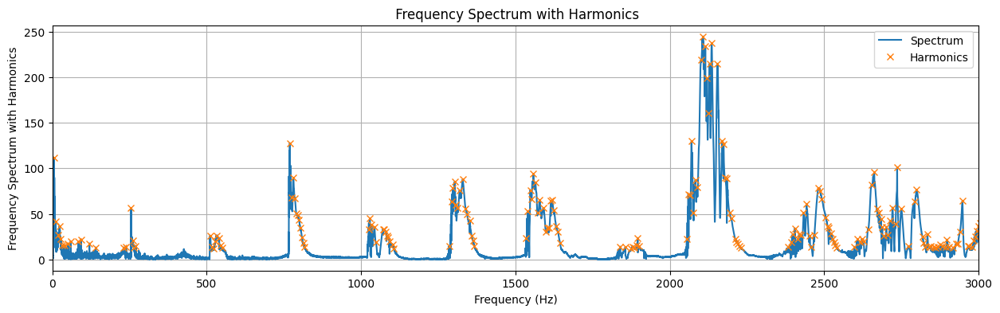

In [13]:
# selected_instruments = ['harp_1-2', 'harp_1-3', 'harp_1-4', 'harp_1-10']
selected_instruments = ['harp_1-2', 'harp_1-10']
selected_notes = ['C4']
filtered_recipes = filter_recipes(recipes, selected_instruments, selected_notes)

display_recipe_matrix(filtered_recipes)


*   **Impulsive Excitation**</br>


<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/unnamed.jpg" width="300"/>
<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/%E6%88%AA%E5%B1%8F2024-11-20%2019.34.52.png" width="300"/>

</br>

*   **Sustained Excitation**</br>
<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/%E6%88%AA%E5%B1%8F2024-11-20%2019.16.13.png" width="300"/></br>
Helmholtz Motion v.s Non-Helmholtz Motion:</br>
<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/640%20(1).gif" width="300"/>
<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/640.gif" width="300"/></br>

# Percussion instruments（打楽器）



*   Drum</br>
<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/images.jpeg" width="300"/>
<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/percussion-1.png" width="800"/>


</br>

*   Cymbal</br>
<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/%E6%88%AA%E5%B1%8F2024-11-20%2019.06.40.png" width="300"/>





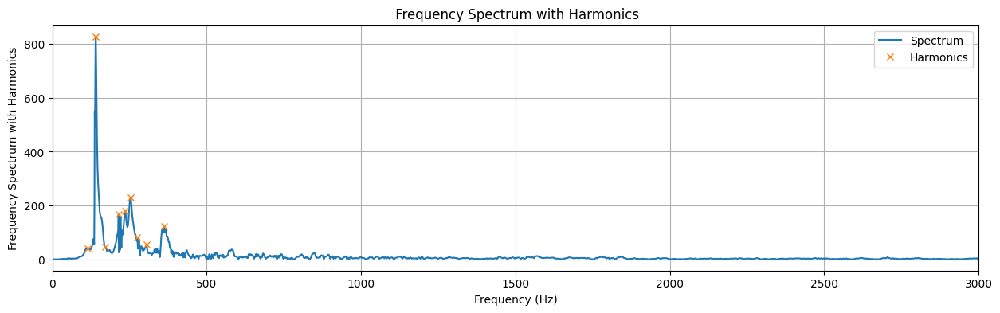
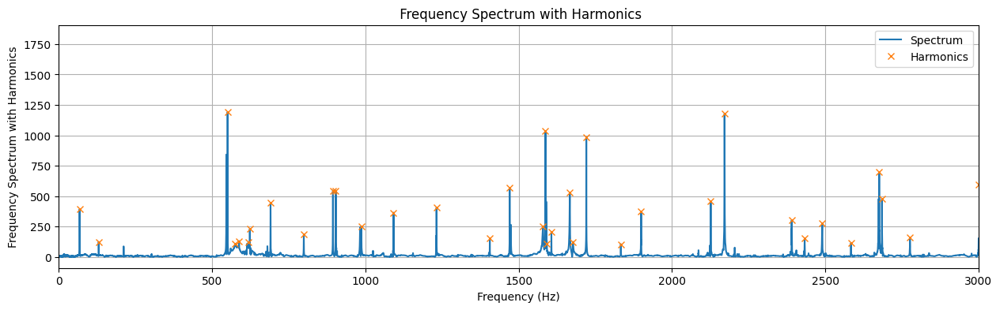

In [14]:
selected_instruments = ['drum', 'cymbal']
selected_notes = ['hit']
filtered_recipes = filter_recipes(recipes, selected_instruments, selected_notes)

display_recipe_matrix(filtered_recipes)

# Wind instruments（管楽器）

red line: pressure（圧力）</br>
blue line: montion（振動）

<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/wind-6.jpg" width="1000"/>





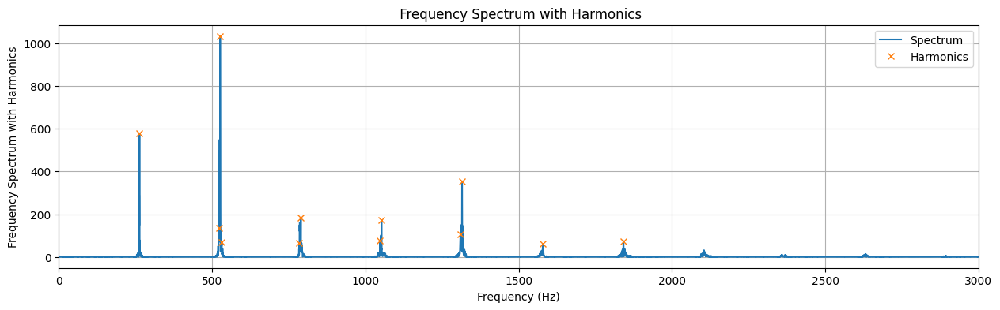
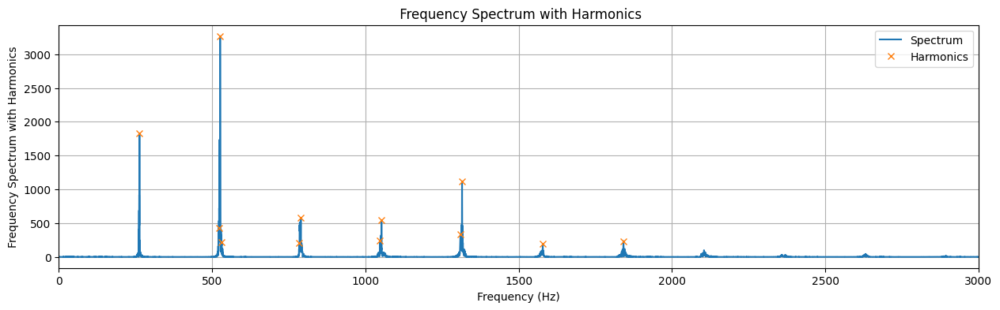
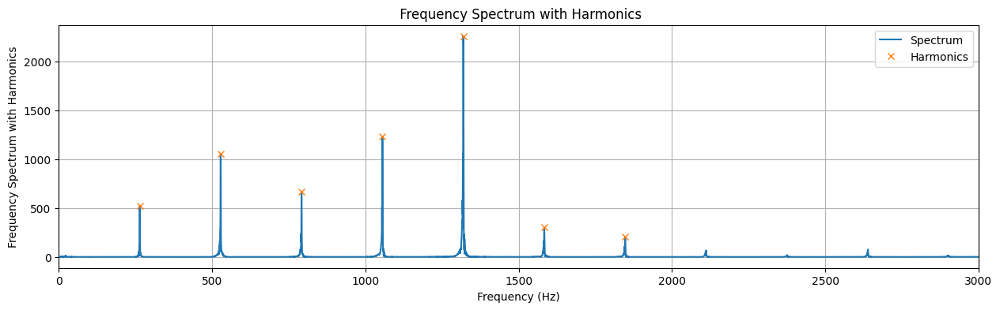
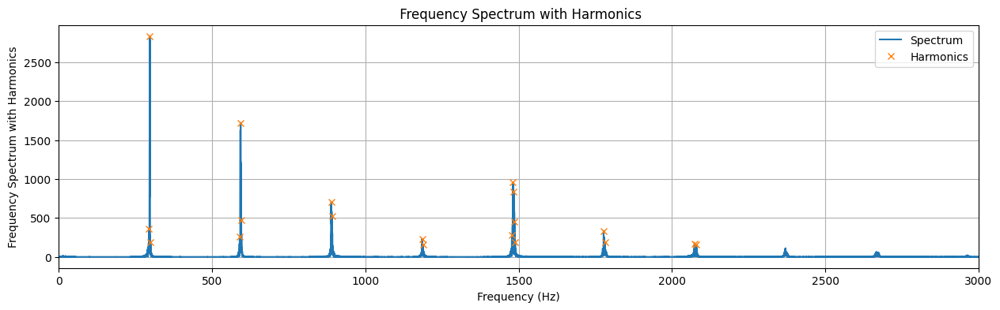
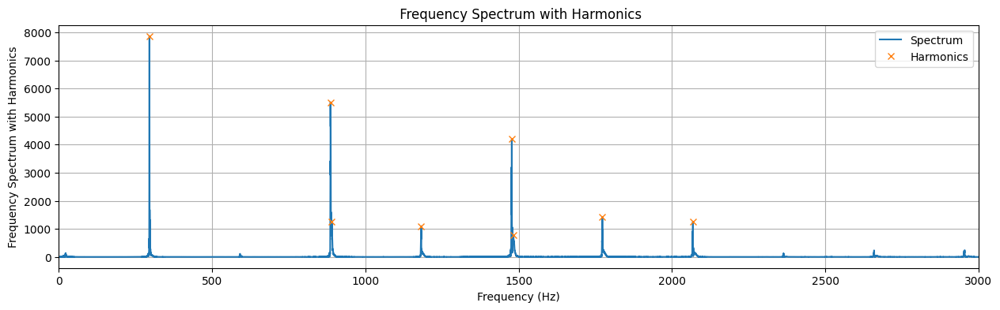
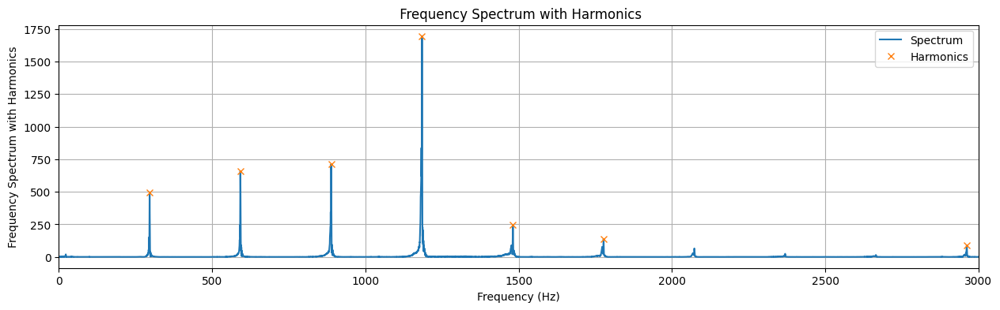
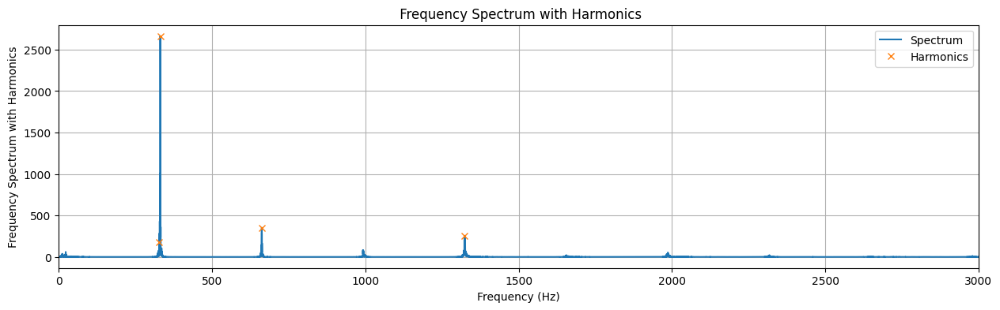
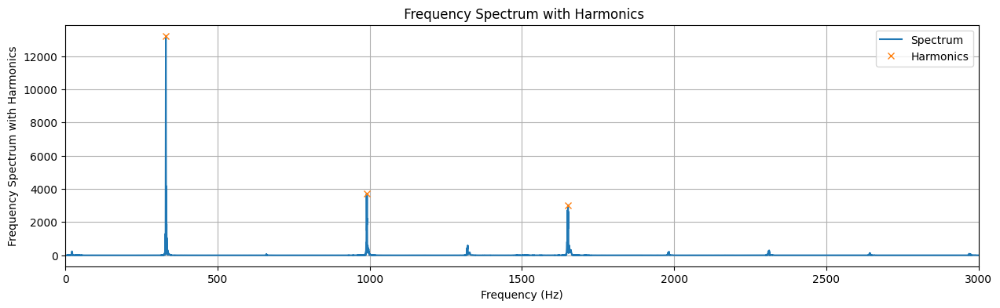
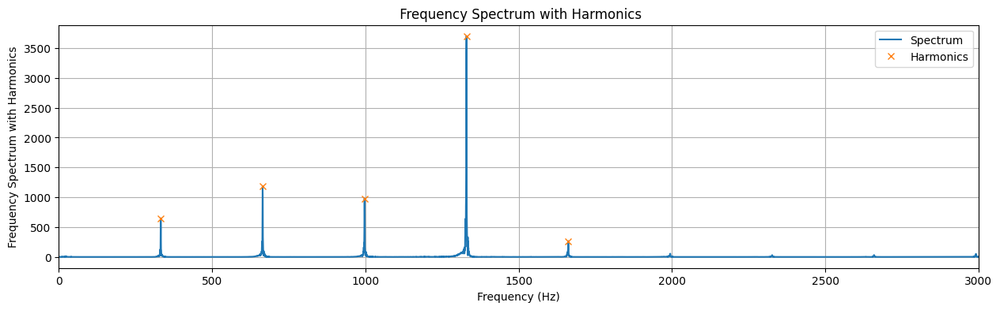

In [15]:
selected_instruments = ['flute', 'clarinet', 'oboe']
selected_notes = ['C4', 'D4', 'E4']
filtered_recipes = filter_recipes(recipes, selected_instruments, selected_notes)

display_recipe_matrix(filtered_recipes)

# Brass instrument（金管楽器）

<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/wind-trumpet-1.jpg" width="800"/>

<img src="https://raw.githubusercontent.com/Nekoiii/instruments-simulation/refs/heads/main/assets/images/wind-trumpet-4.jpg" width="1000"/>



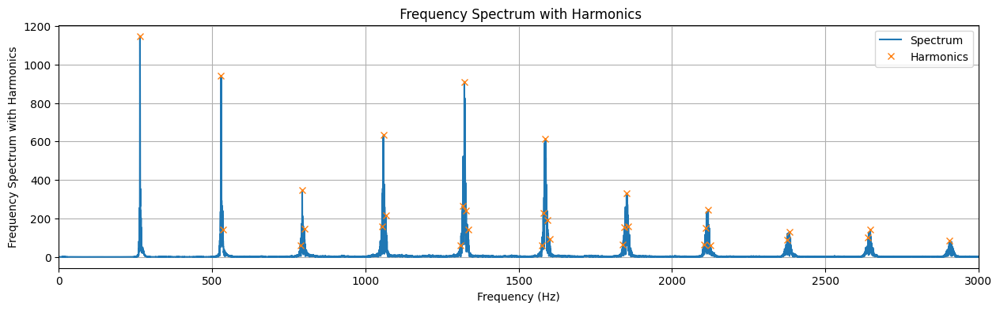
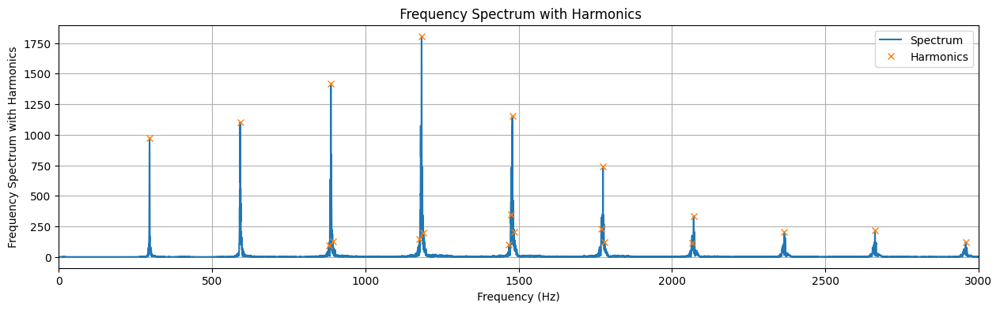
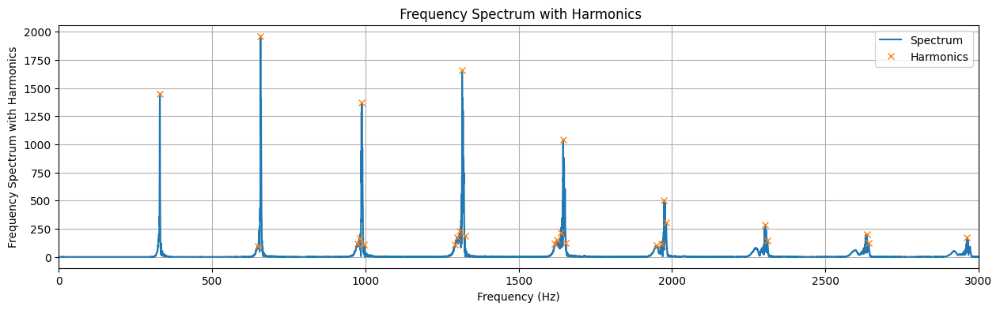

In [16]:
selected_instruments = ['trumpet']
selected_notes = ['C4', 'D4', 'E4']
filtered_recipes = filter_recipes(recipes, selected_instruments, selected_notes)

display_recipe_matrix(filtered_recipes)

# 其他影响音色的因素

Envelope

ADSR: </br>
Attack (second): Time to rise from 0 to peak amplitude after note is triggered. </br>
Decay (second): Time to fall from peak amplitude to sustain level. </br>
Sustain (0 ~ 1): Amplitude maintained while the note is held. </br>
Release (second): Time to fall from sustain level to 0 after note </br>






Example 1: (Attack 0.1 %, Decay 0.3 %, Sustain 0.3 % (Sustain Level 0.5), Release 0.3) %


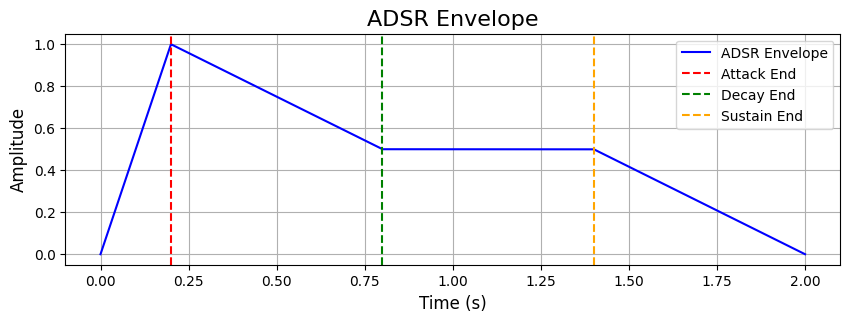

Example 2: (Attack 0.7 %, Decay 0.1 %, Sustain 0.1 % (Sustain Level 0.5), Release 0.1) %


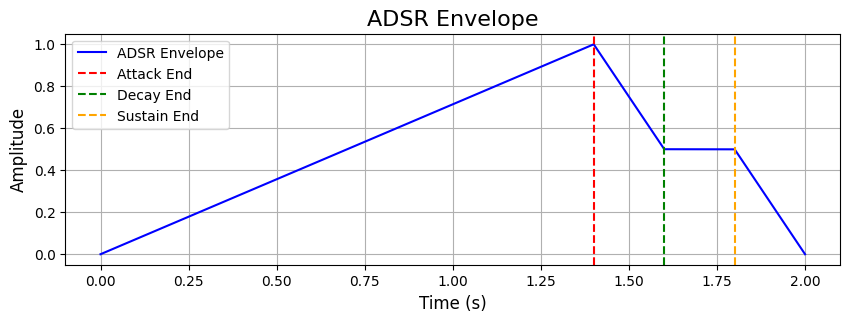

Example 3: (Attack 0.3 %, Decay 0.1 %, Sustain 0.3 % (Sustain Level 0.5), Release 0.3) %


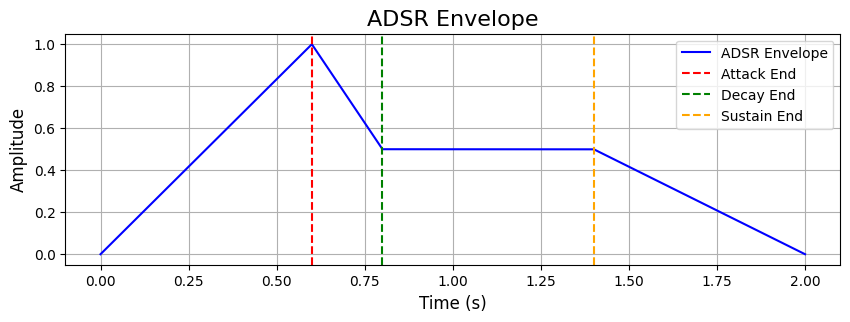

Example 4: (Attack 0.1 %, Decay 0.7 %, Sustain 0.1 % (Sustain Level 0.5), Release 0.1) %


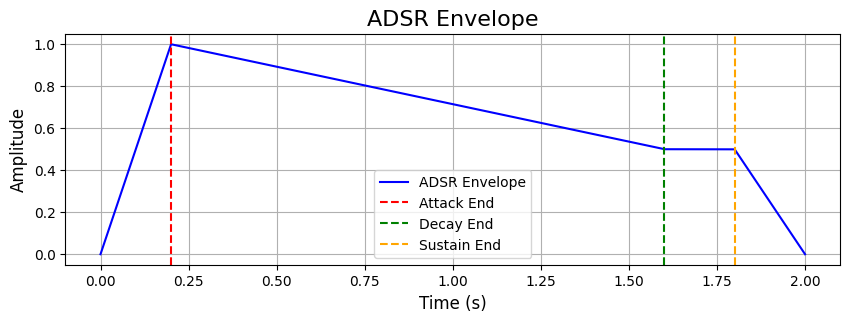

Example 5: (Attack 0.3 %, Decay 0.3 %, Sustain 0.1 % (Sustain Level 0.5), Release 0.3) %


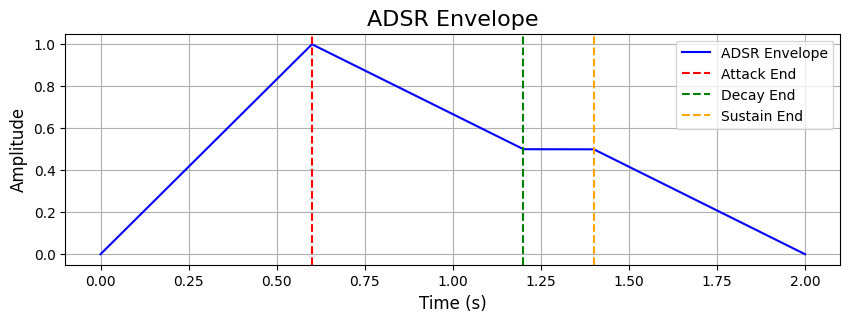

Example 6: (Attack 0.1 %, Decay 0.1 %, Sustain 0.7 % (Sustain Level 0.5), Release 0.1) %


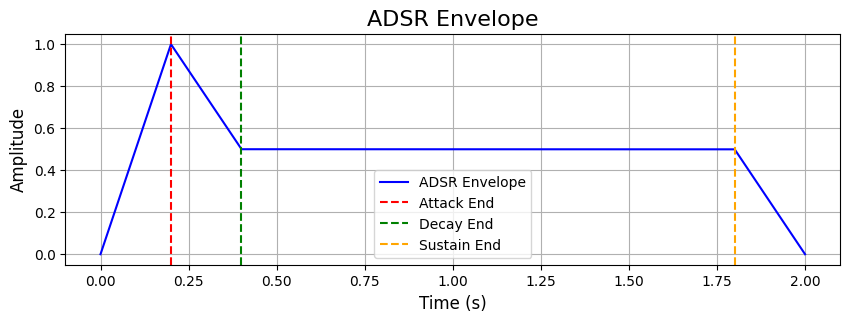

Example 7: (Attack 0.3 %, Decay 0.3 %, Sustain 0.3 % (Sustain Level 0.5), Release 0.1) %


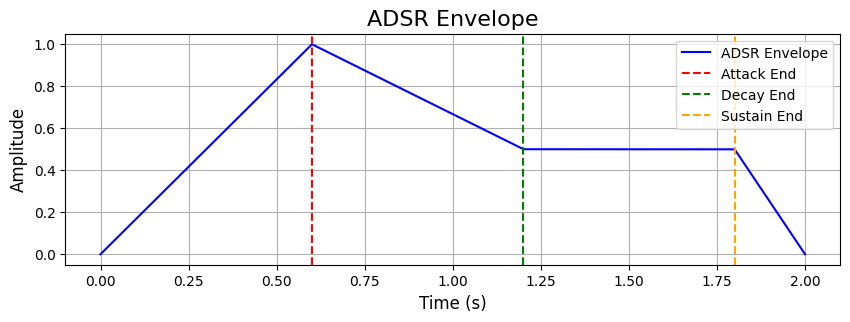

Example 8: (Attack 0.1 %, Decay 0.1 %, Sustain 0.1 % (Sustain Level 0.5), Release 0.7) %


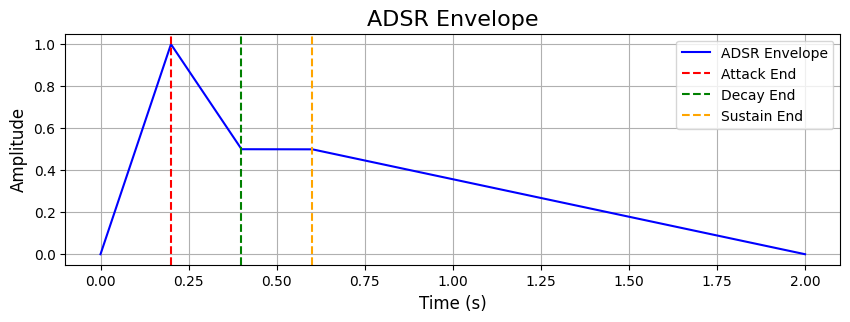

Example 9: (Attack 0.25 %, Decay 0.25 %, Sustain 0.2 % (Sustain Level 0.1), Release 0.25) %


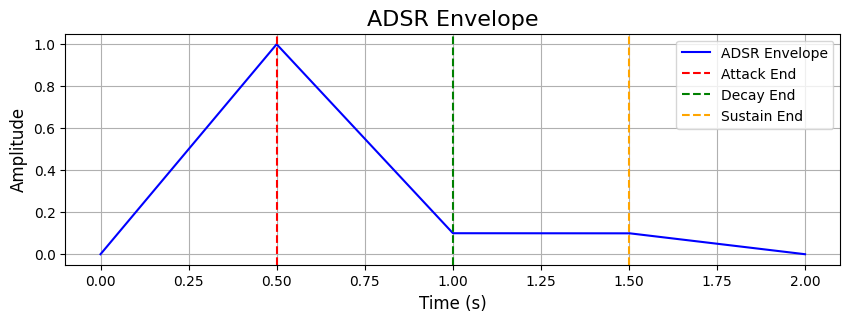

Example 10: (Attack 0.25 %, Decay 0.25 %, Sustain 0.2 % (Sustain Level 0.9), Release 0.25) %


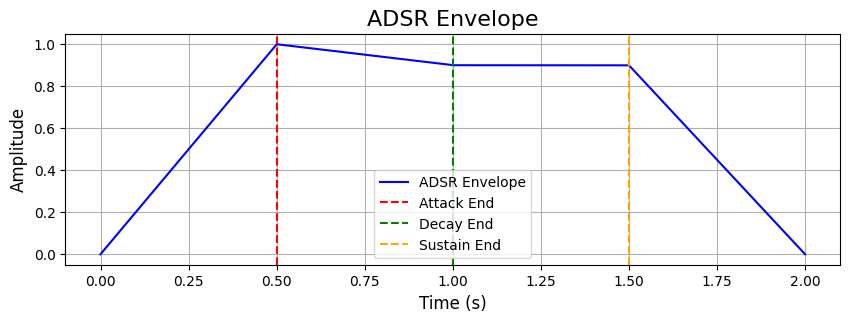

In [17]:
def make_envelope(attack_time, decay_time, sustain_level, release_time, sample_rate=44100, duration=2):
    time = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)
    envelope = np.zeros_like(time)

    for i, t in enumerate(time):
        if t < attack_time:
            envelope[i] = t / attack_time
        elif t < attack_time + decay_time:
            t_decay = t - attack_time
            envelope[i] = 1 - (1 - sustain_level) * (t_decay / decay_time)
        elif t < duration - release_time:
            envelope[i] = sustain_level
        else:
            t_release = t - (duration - release_time)
            envelope[i] = sustain_level * (1 - t_release / release_time)

    return time, envelope

def generate_adsr_wave(origin_wave, attack_time, decay_time, sustain_level, release_time, sample_rate, duration, filename=None):
    time, envelope = make_envelope(attack_time, decay_time, sustain_level, release_time, sample_rate, duration)
    adsr_wave = origin_wave * envelope

    if filename:
        write(filename, sample_rate, (adsr_wave * 32767).astype(np.int16))
        display(Audio(filename))

    plt.figure(figsize=(10, 3))
    plt.plot(time, envelope, label="ADSR Envelope", color="blue")
    plt.title("ADSR Envelope", fontsize=16)
    plt.xlabel("Time (s)", fontsize=12)
    plt.ylabel("Amplitude", fontsize=12)
    plt.axvline(x=attack_time, color='red', linestyle='--', label='Attack End')
    plt.axvline(x=attack_time + decay_time, color='green', linestyle='--', label='Decay End')
    plt.axvline(x=duration - release_time, color='orange', linestyle='--', label='Sustain End')
    plt.legend()
    plt.grid()
    plt.show()

    return adsr_wave

sample_rate = 44100
duration = 2
freq = 440.0
time = np.linspace(0, duration, int(sample_rate * duration), endpoint=False)
origin_wave = 0.5 * np.sin(2 * np.pi * freq * time)

# Attack(%), Decay(%), Sustain Level(0~1. Sustain proportion = 1 - others), Release(%)
adsr_examples = [
    (0.1, 0.3, 0.5, 0.3),
    (0.7, 0.1, 0.5, 0.1),

    (0.3, 0.1, 0.5, 0.3),
    (0.1, 0.7, 0.5, 0.1),

    (0.3, 0.3, 0.5, 0.3),
    (0.1, 0.1, 0.5, 0.1),

    (0.3, 0.3, 0.5, 0.1),
    (0.1, 0.1, 0.5, 0.7),


    (0.25, 0.25, 0.1, 0.25),
    (0.25, 0.25, 0.9, 0.25),
]

for i, (attack_ratio, decay_ratio, sustain_level, release_ratio) in enumerate(adsr_examples):
    print(f"Example {i + 1}: (Attack {attack_ratio} %, Decay {decay_ratio} %, Sustain {1-attack_ratio-decay_ratio-release_ratio:.1f} % (Sustain Level {sustain_level}), Release {release_ratio}) %")
    filename = f"adsr_example_{i + 1}.wav"
    attack_time = attack_ratio * duration
    decay_time = decay_ratio * duration
    release_time = release_ratio * duration
    generate_adsr_wave(origin_wave, attack_time, decay_time, sustain_level, release_time, sample_rate, duration, filename=filename)

In [18]:
example_path = real_audio_paths['piano']['C4']

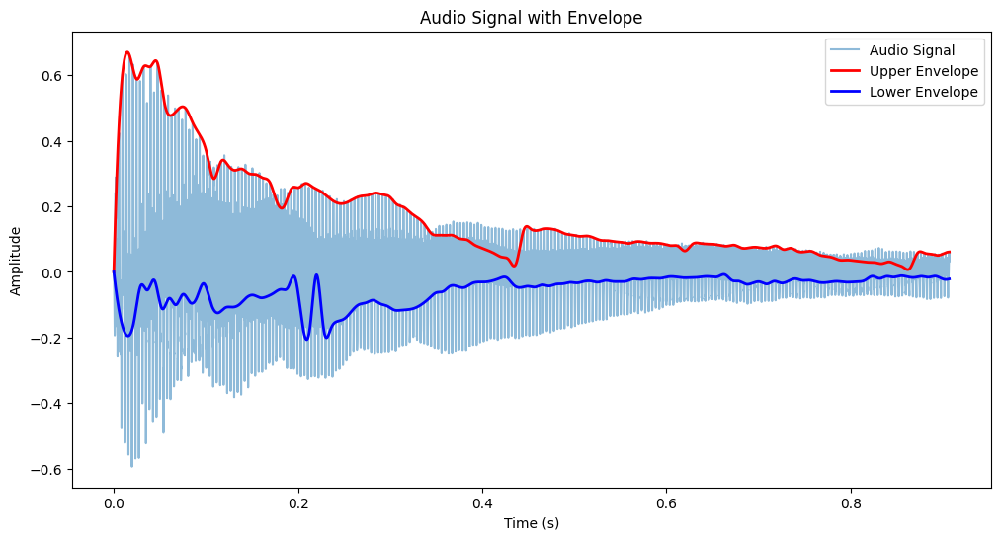

In [19]:
from scipy.interpolate import interp1d
from scipy.signal import savgol_filter

def get_audio_envelope(audio_path, min_interval=1000):
    audio, sr = sf.read(audio_path)
    if len(audio.shape) > 1:
        audio = np.mean(audio, axis=1)

    time = np.linspace(0, len(audio) / sr, len(audio))
    positive_part = np.maximum(audio, 0)
    negative_part = -np.minimum(audio, 0)

    def get_envelope(x, y, min_interval):
        x_list, y_list = list(x), list(y)

        indices, x_points, y_points = [0], [x_list[0]], [y_list[0]]
        last_idx = 0

        threshold = 0.01 * np.max(audio)
        for i in range(1, len(x_list)-1):
            if (y_list[i] >= y_list[i-1] and y_list[i] >= y_list[i+1] and y_list[i] > threshold and (i - last_idx >= min_interval)):
                indices.append(i)
                x_points.append(x_list[i])
                y_points.append(y_list[i])
                last_idx = i

        indices.append(len(x_list)-1)
        x_points.append(x_list[-1])
        y_points.append(y_list[-1])

        func = interp1d(x_points, y_points, kind='cubic', bounds_error=False, fill_value=('extrapolate'))
        return func(x_list)



    upper_envelope = get_envelope(time, positive_part, min_interval)
    lower_envelope = -get_envelope(time, negative_part, min_interval)
    return time, audio, sr, upper_envelope, lower_envelope

def plot_audio_with_envelope(time, audio_path, upper_envelope, lower_envelope=None, showing_range=None):
    audio, sr = sf.read(audio_path)
    if len(audio.shape) > 1:
        audio = np.mean(audio, axis=1)
    if lower_envelope is None:
        lower_envelope = -upper_envelope
    if showing_range is None:
        showing_range = len(time)

    plt.figure(figsize=(12, 6))
    plt.plot(time[:showing_range], audio[:showing_range], label='Audio Signal', alpha=0.5)
    plt.plot(time[:showing_range], upper_envelope[:showing_range], label='Upper Envelope', color='red', linewidth=2)
    plt.plot(time[:showing_range], lower_envelope[:showing_range], label='Lower Envelope', color='blue', linewidth=2)
    plt.title('Audio Signal with Envelope')
    plt.xlabel('Time (s)')
    plt.ylabel('Amplitude')
    plt.legend()
    plt.show()


audio_path = example_path
min_interval = 300
time, audio, sr, upper_envelope, lower_envelope = get_audio_envelope(audio_path, min_interval)
plot_audio_with_envelope(time, audio_path, upper_envelope, lower_envelope, showing_range=40000 )


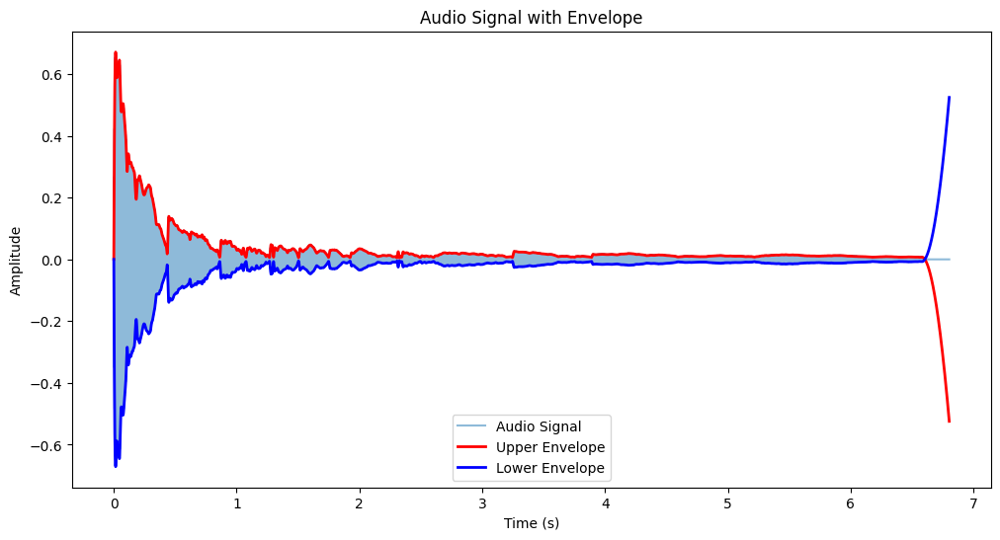

In [21]:

def generate_tone(frequency, duration, sr):
    t = np.linspace(0, duration, int(sr * duration), endpoint=False)
    tone = np.sin(2 * np.pi * frequency * t)
    return tone


def apply_envelope_to_tone(envelope, tone):
    min_length = min(len(envelope), len(tone))
    envelope = envelope[:min_length]
    tone = tone[:min_length]

    interpolated_envelope = np.maximum(envelope, 0)

    modulated_tone = interpolated_envelope * tone
    return modulated_tone

def save_audio(file_path, audio, sr):
    sf.write(file_path, audio, sr)


frequency = 440

duration = len(audio) / sr
new_tone = generate_tone(frequency, duration, sr)


modulated_audio = apply_envelope_to_tone(upper_envelope, new_tone)


output_path = 'modulated_audio.wav'
save_audio(output_path, modulated_audio, sr)
display(Audio(output_path))


plot_audio_with_envelope(time, output_path, upper_envelope, showing_range=30000)

